<h1 class="heading">Wind Reconstructor</h1>
<h1>Actuator Disk Model. Case (1,2)</h1>

<h6 class="author"> — <b style="color:rgb(0,51,102);">Carmine Varriale, Agostino De Marco</b>, <i>University of Naples Federico II</i></h6>

## Introduction
In this notebook, we are going to simulate the flight of our aircraft through the middle of the wake of a wind turbine.
The aircraft is a modified version of the Cessna 172 Skyhawk: it has been scaled down from a geometric and inertial point of view, in order to be closer to an Ikarus C42, for which some theoretical results are available from a previous study. The aerodynamic model has not been changed at all, considering that the two aircraft have comparable configurations overall.
<br><br>
The turbine is represented by an actuator disk model, and the inflow by an atmospheric boundary layer profile

## Case specific settings
Wind speed at the actuator disk is $12\ \mathrm{m/s}$. <br>
Wind direction is $270°$ with respect to local north, i.e. the turbine is working with perfectly axial wind.

In [1]:
% run ./python/nb_init.py
% matplotlib inline

import numpy as np
import utm

import geography as geo
import data_handling as dh
from property_map import pmap
from MCSim import *

In [2]:
# Turbine diameter
D_t = 120 #m

# Assign turbine Lat-Lon coordinates and height
Lat_t = 53.153588 #deg
Lon_t = 8.162655  #deg
H_t   = 120       #m

# Calculate turbine UTM coordinates
X_t, Y_t, zone_num, zone_lett = utm.from_latlon(Lat_t, Lon_t)
print("X_t =  {0:.14f} m (Easting coord.)".format(X_t), sep="")
print("Y_t =  {0:.14f} m (Northing coord.)".format(Y_t), sep="")

X_t =  444005.64156725001521 m (Easting coord.)
Y_t =  5889683.58956928178668 m (Northing coord.)


<div class="main">
At this point, we can <b>manually</b> translate the whole mesh in order to give the turbine the above coordinates in UTM reference frame. By default, the simulation has been run with turbine position being $(0.0, 0.0, 120.0)$, so the command to run in the OpenFoam case directory is simply
<div class="path">transformPoints -translate "(X_t Y_t 0.0)"</div>

<br><br>

For a quick check, it might be worth to also execute
<div class="path">checkMesh >& log.checkMesh &</div>
</div>

In [3]:
# List of distances from the disk, in terms of turbine diameters
# The length of the list is equal to the number of simulations for each speed value
nD_t = [0,1,2,3,4,9,14,19]

# Calculate aircraft initial positions, relative to turbine, in UTM
X0 = list(X_t + np.asarray(nD_t)*D_t)
Y0 = Y_t - 1500

At this point, we have the full set of initial and corresponding final positions of the aircraft. Our goal is to create a simulation family for each of this couples: within the family, initial speed will be fixed while initial position with respect to the turbine will vary, thanks to the already well known <span class="typewr">generate_series</span> function. Finally, the aircraft initial speed and altitude will also be iterated in the set, through a simple external <span class="typewr">for</span> loop.

## Simulation control panel

In [4]:
vV =      [50,    100]     #kts
vh =      [146, 146]       #m
vDeltaX = [-395,   -135.5] #m   (initial position corrections for first fly-through at 1 diameter)

for i in range(len(vV)):
    script     = 'c172mod_OF_ADM'
    autopilot  = 'c172ap_unina_mod'
    output_fol = 'c172mod_OF_ADM12_V'+str(vV[i])

    # Creating instance of the class
    ADM12 = WRSimFamily(len(nD_t), 
                        seed_name      = script,
                        autopilot_name = autopilot,
                        out_foldername = output_fol,
                        port_num=1025)
    
    # Correct initial position on the basis of initial speed
    X0corr = [x0 + vDeltaX[i] for x0 in X0]

    # Calculate waypoints positions in UTM
    X1 = X0corr ; Y1 = Y_t + 1500

    # Convert such positions to Lat-Lon coordinates
    def LatLon_from_utm(X, Y, zone_num, zone_lett):
        LatLon = [utm.to_latlon(X[i], Y, zone_num, zone_lett) for i in range(len(nD_t))]
        Lat = [LatLon[i][0] for i in range(len(X))] #deg
        Lon = [LatLon[i][1] for i in range(len(X))] #deg
        return Lat, Lon

    Lat0, Lon0 = LatLon_from_utm(X0corr, Y0, zone_num, zone_lett)
    Lat1, Lon1 = LatLon_from_utm(X1, Y1, zone_num, zone_lett)
    
    
    # Initial positions
    ADM12.generate_series('latitude', 'from_list', Lat0)
    ADM12.generate_series('longitude', 'from_list', Lon0)

    # Waypoint positions
    ADM12.generate_series('guidance/target-wp-latitude-rad-final',  'from_list', np.radians(Lat1))
    ADM12.generate_series('guidance/target-wp-longitude-rad-final', 'from_list', np.radians(Lon1))

    # Flight parameters
    h_m       = ADM12.set_value('altitude', vh[i])
    psi_deg   = ADM12.set_value('psi', 0)
    gamma_deg = ADM12.set_value('gamma', -1)
    V_kts     = ADM12.set_value('vt', vV[i])
    
    # Launch family of simulations
    #ADM12.launch_mc_sim(log='off', system='linux')

Running all instances in background...
Organizing files and folders...
Total time required: 1109.66 s
Running all instances in background...
Organizing files and folders...
Total time required: 477.89 s


In [24]:
GrA = PostGroup('c172mod_OF_ADM12_V'+str(vV[0]), 'c172x_unina_mod', list(range(1,len(nD_t)+1)),'A')
#GrA.get_traj_in_UTM()
GrA.load_traj_in_UTM()

GrB = PostGroup('c172mod_OF_ADM12_V'+str(vV[1]), 'c172x_unina_mod', list(range(1,len(nD_t)+1)),'B')
#GrB.get_traj_in_UTM()
GrB.load_traj_in_UTM()

Total time required: 4.41 s
Total time required: 1.53 s


## Extracting position at crossing point for validity check

In [25]:
def takeClosest(myList, myNumber):
    
    from bisect import bisect_left
    
    pos = bisect_left(myList, myNumber)
    if pos == 0:
        return pos, myList[0]
    if pos == len(myList):
        return pos, myList[-1]
    before = myList[pos - 1]
    after = myList[pos]
    if after - myNumber < myNumber - before:
        return pos, after
    else:
        return pos, before
    
    
def getInfoAtCrossing(MCSimGroup, XY_turb, windDir):
    
    Xt = XY_turb[0]  ; Yt = XY_turb[1] 
    
    print('Idx ', 'Altit.', 'Dist.', sep='   ')
    print('------------------------')
    
    for i in MCSimGroup.indexes:
        s = '{:04}'.format(i)
        
        # Create line passing through turbine, and aligned with the wind direction
        if windDir == 90 or windDir == 270:
            deltaY = list(np.asarray(MCSimGroup.group[s].P['Nutm_m']) - Yt)
            index, delta = takeClosest(deltaY, 0)            
        else:
            Xw = Xt + np.tan(np.radians(windDir))*(np.asarray(MCSimGroup.group[s].P['Nutm_m']) - Yt)
            print(Xw, np.asarray(MCSimGroup.group[s].P['Eutm_m']), sep='\n')
        
            # Find intersection point with trajectory
            deltaX = list(np.asarray(MCSimGroup.group[s].P['Eutm_m']) - Xw)
            index, delta = takeClosest(deltaX, 0)

        # Calculate height at intersection
        h = MCSimGroup.group[s].J[pmap['h_agl_m']['property']][index]

        # Calculate distance at intersection
        X = MCSimGroup.group[s].P['Eutm_m'][index]
        Y = MCSimGroup.group[s].P['Nutm_m'][index]
        d = np.sqrt((X-Xt)**2+(Y-Yt)**2)
        
        print(s, "{:.2f}".format(h), "{:.2f}".format(d), sep='   ')

In [26]:
getInfoAtCrossing(GrA, (X_t, Y_t), 270)

Idx    Altit.   Dist.
------------------------
0001   120.33   119.75
0002   120.12   239.56
0003   120.06   359.37
0004   120.06   479.00
0005   120.06   598.84
0006   120.17   1198.23
0007   120.25   1797.74
0008   120.30   2397.29


In [27]:
getInfoAtCrossing(GrB, (X_t, Y_t), 270)

Idx    Altit.   Dist.
------------------------
0001   120.79   120.45
0002   120.70   240.41
0003   120.64   360.37
0004   120.59   480.33
0005   120.56   600.28
0006   120.52   1200.01
0007   120.55   1799.47
0008   120.55   2399.23


## Trajectory

In [28]:
GrA.plot_ground_track_UTM(origin=[X_t, Y_t], ax_lim=[-500, +5500, -3000, +3000], lbl_idx=0)
GrB.plot_ground_track_UTM(origin=[X_t, Y_t], ax_lim=[-500, +5500, -3000, +3000], lbl_idx=0)

Total time required: 0.50 s
Total time required: 0.50 s


Total time required: 0.48 s
Total time required: 0.35 s


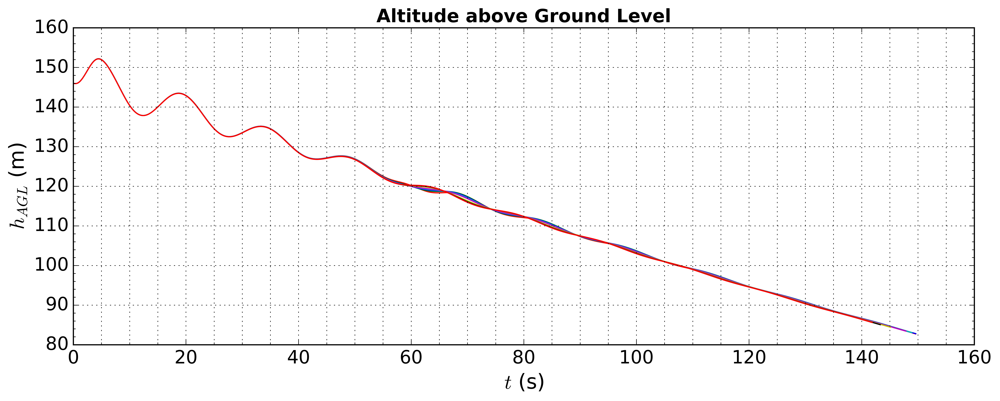

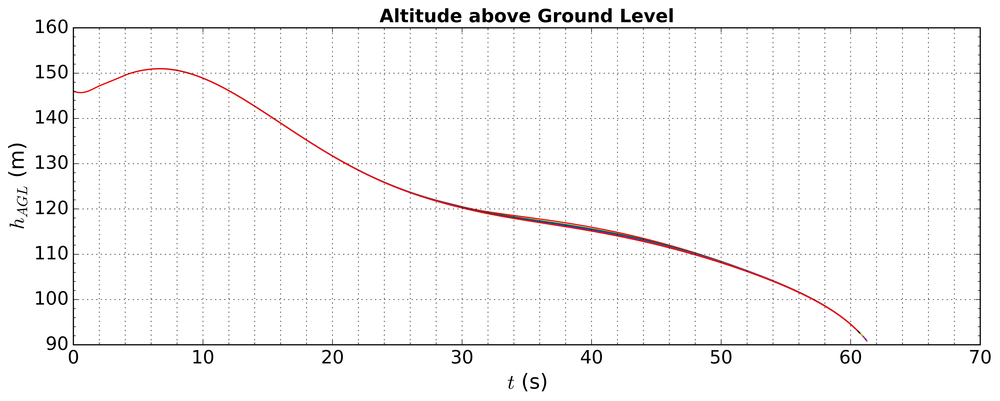

In [29]:
GrA.plot_vars('h_agl_m')
GrB.plot_vars('h_agl_m')

In [30]:
GrA.plot_traj3D_UTM(origin=[X_t, Y_t], to_scale='XY', ax_lim=[0,4000,-2000,2000,80,160], \
                    nticks=[11,11,9], view=(40,160), legend='on')
GrB.plot_traj3D_UTM(origin=[X_t, Y_t], to_scale='XY', ax_lim=[0,4000,-2000,2000,80,160], \
                    nticks=[11,11,9], view=(40,160), legend='on')

Total time required: 0.64 s
Total time required: 0.59 s


## Attitude

Total time required: 0.31 s
Total time required: 0.34 s


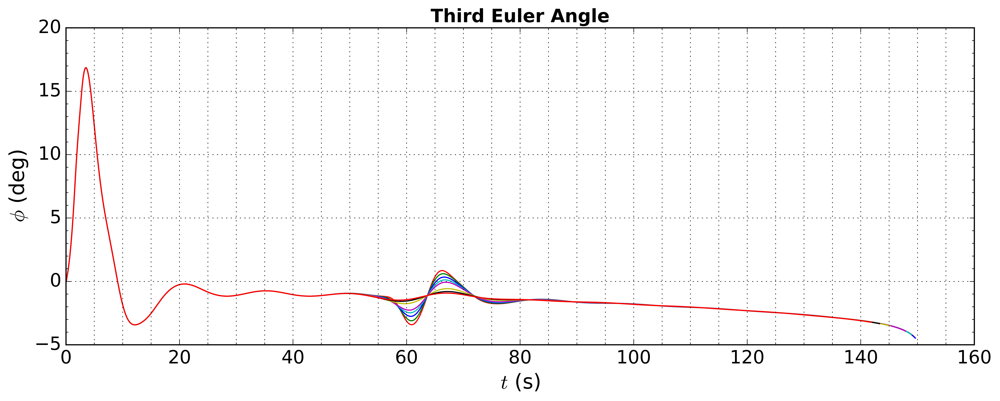

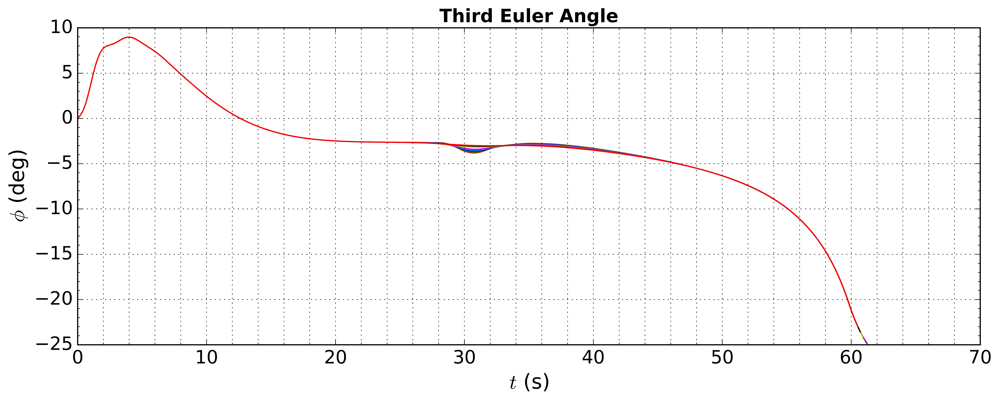

In [31]:
GrA.plot_vars('phi_deg')
GrB.plot_vars('phi_deg')

Total time required: 0.46 s
Total time required: 0.33 s


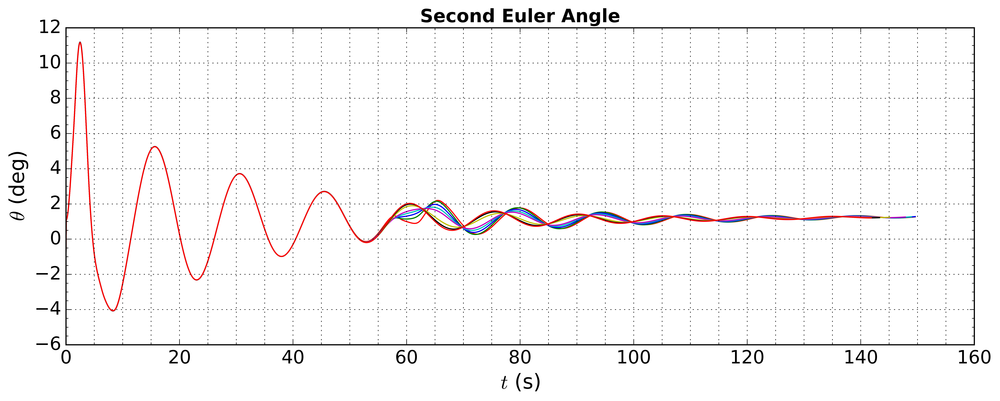

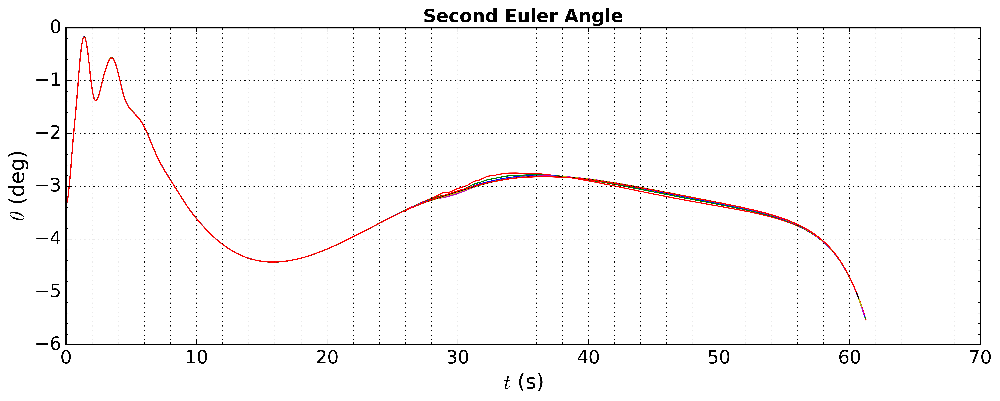

In [32]:
GrA.plot_vars('theta_deg')
GrB.plot_vars('theta_deg')

Total time required: 0.36 s
Total time required: 0.63 s


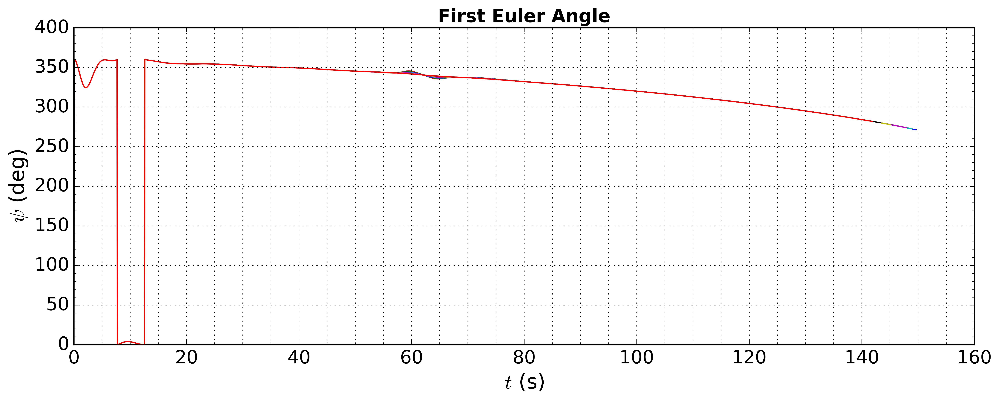

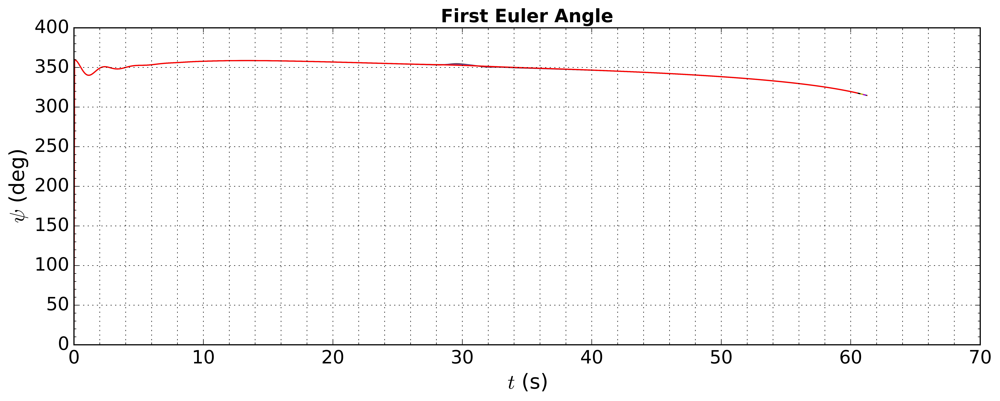

In [33]:
GrA.plot_vars('psi_deg')
GrB.plot_vars('psi_deg')

## Flight control system

Total time required: 0.31 s
Total time required: 0.34 s


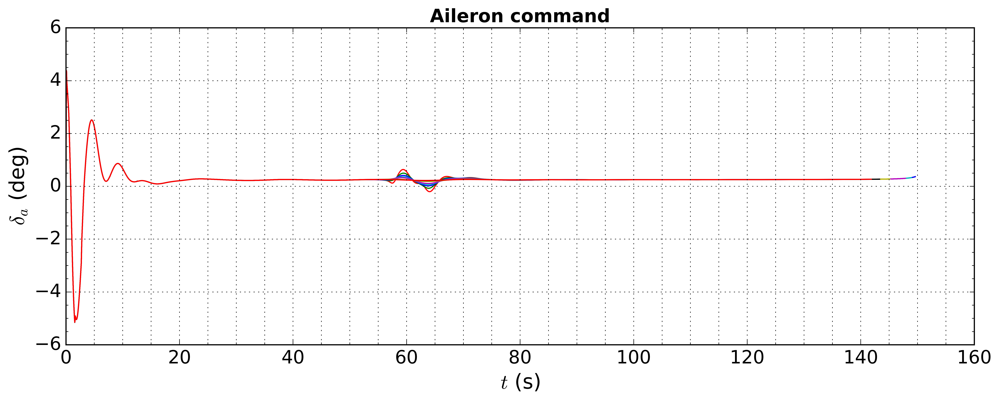

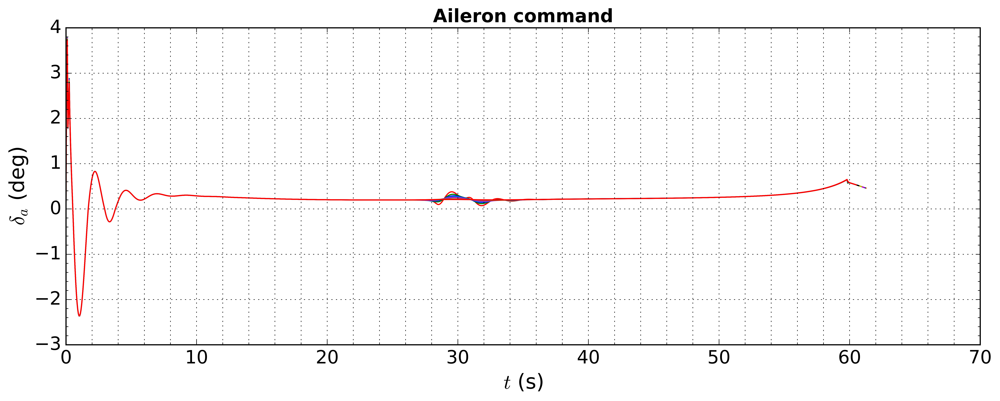

In [34]:
GrA.plot_vars('delta_a')
GrB.plot_vars('delta_a')

Total time required: 0.37 s
Total time required: 0.34 s


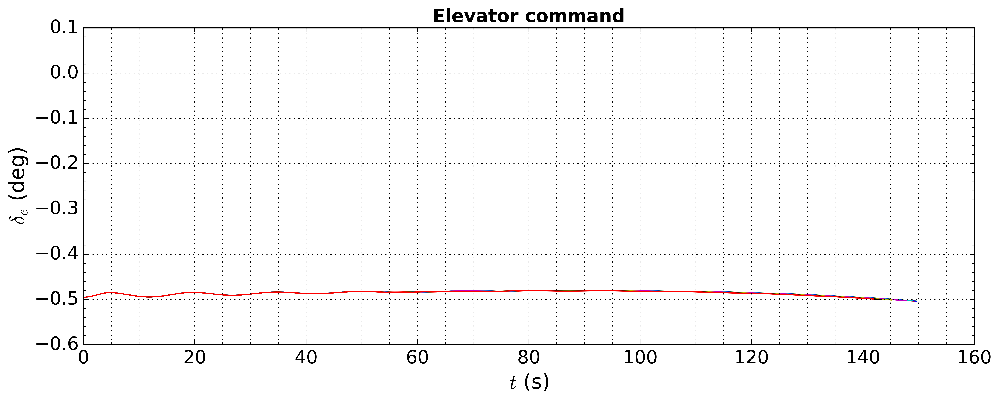

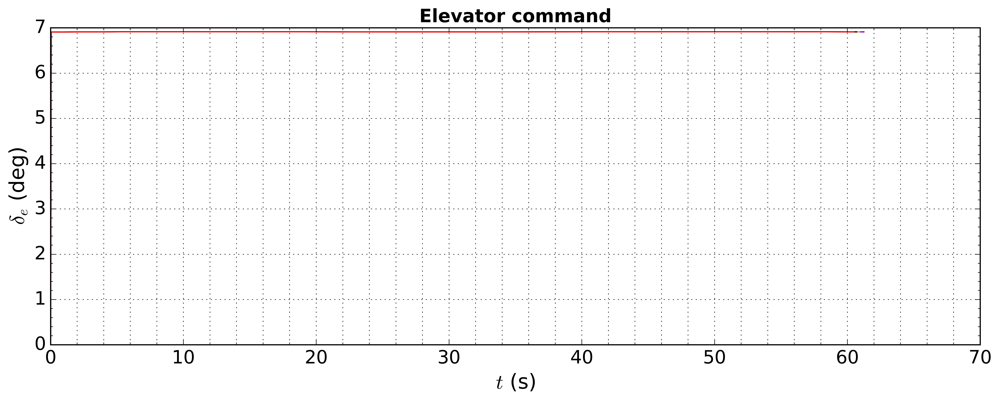

In [35]:
GrA.plot_vars('delta_e')
GrB.plot_vars('delta_e')

Total time required: 0.42 s
Total time required: 0.34 s


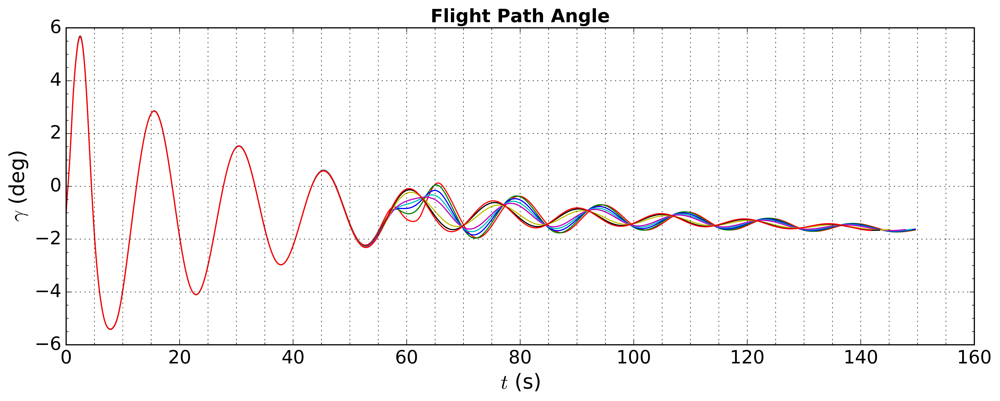

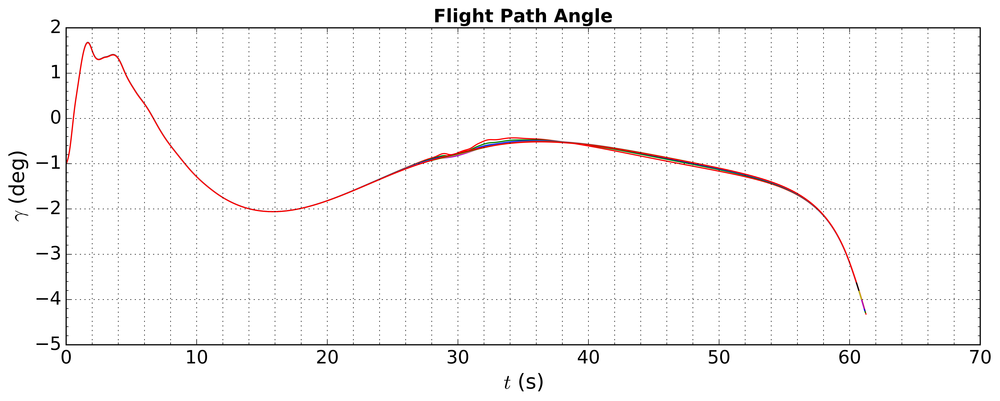

In [36]:
GrA.plot_vars('gamma_deg')
GrB.plot_vars('gamma_deg')

## Wind speed in body reference frame

Total time required: 1.17 s
Total time required: 1.09 s


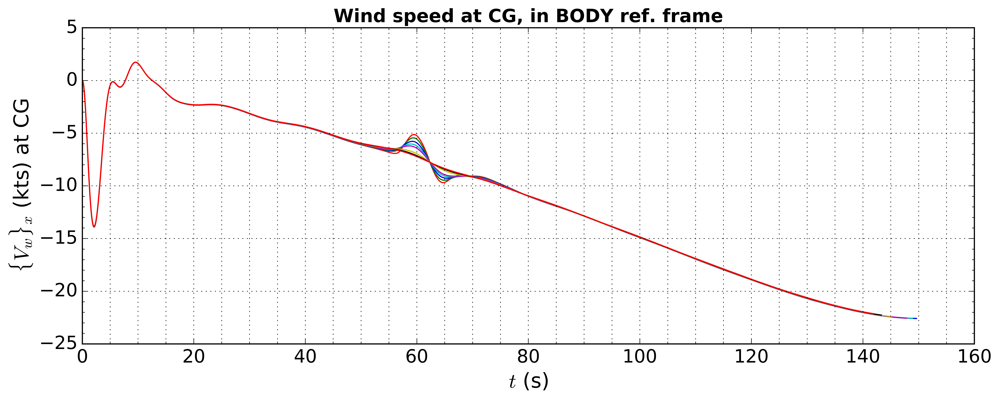

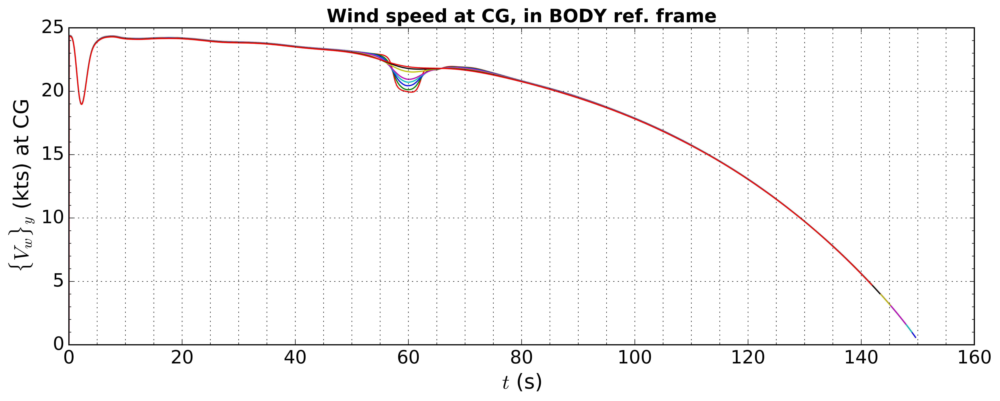

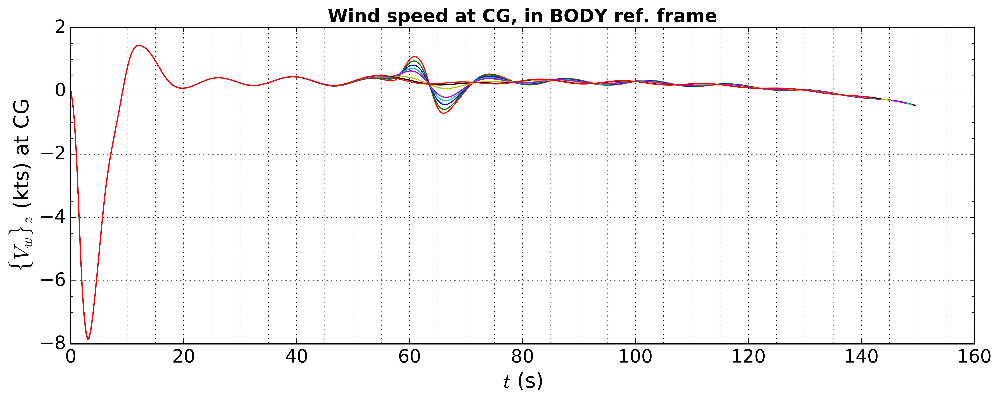

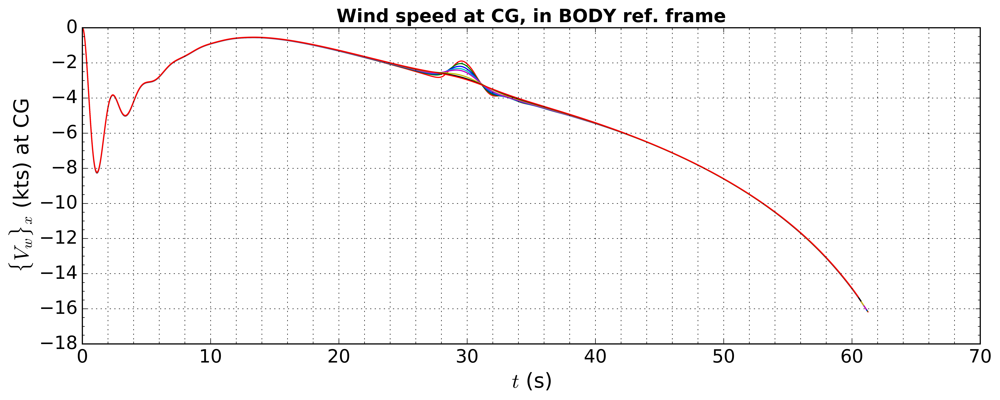

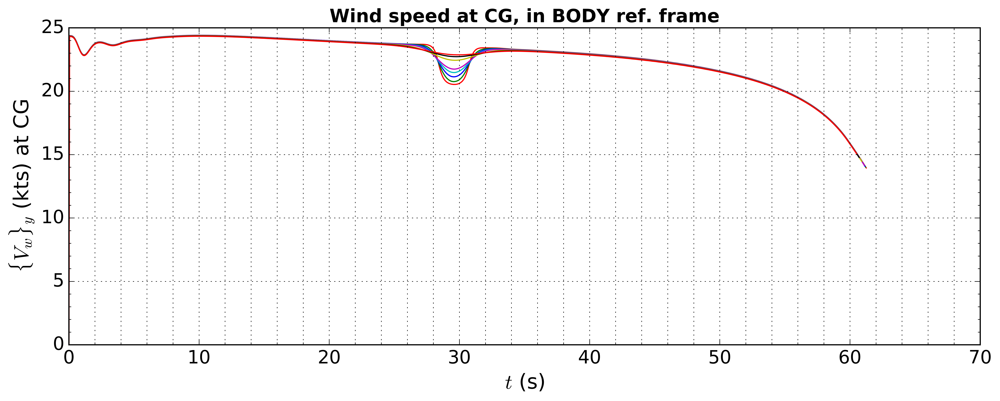

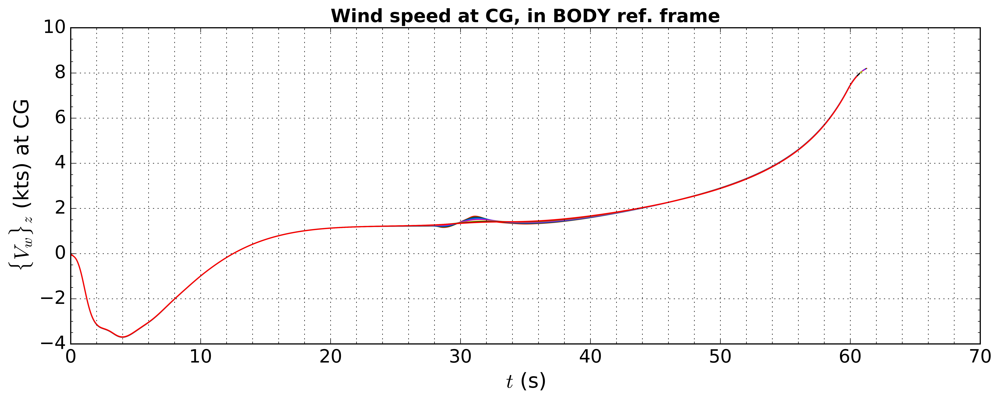

In [37]:
GrA.plot_vars('Vw_x_kts','Vw_y_kts','Vw_z_kts')
GrB.plot_vars('Vw_x_kts','Vw_y_kts','Vw_z_kts')

## Wind speed in UTM reference frame

Total time required: 0.97 s
Total time required: 1.09 s


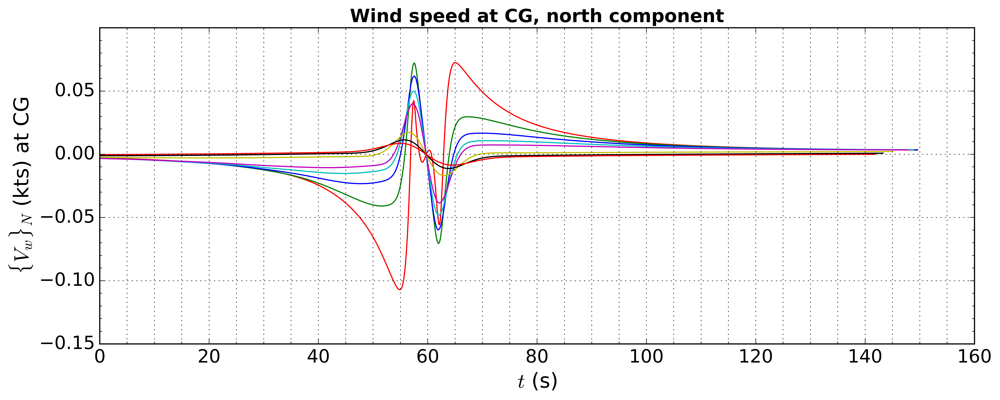

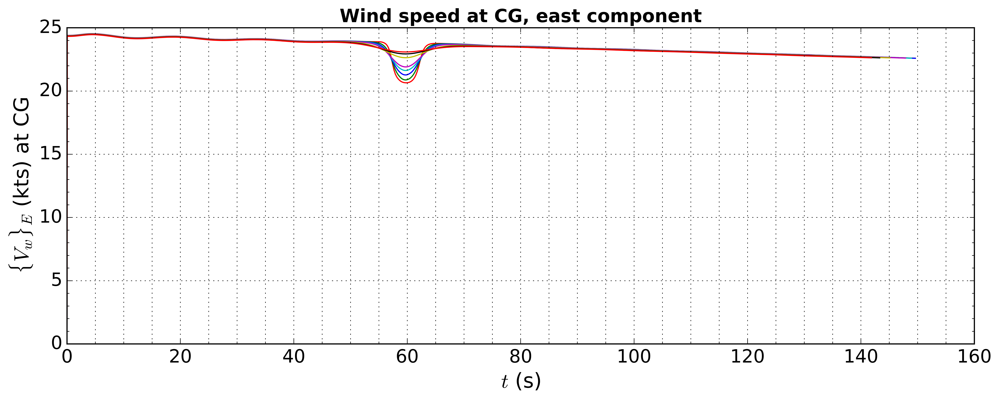

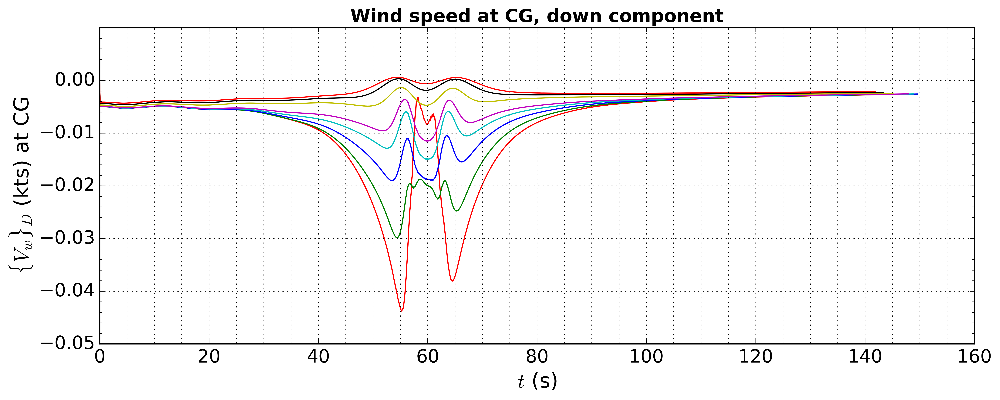

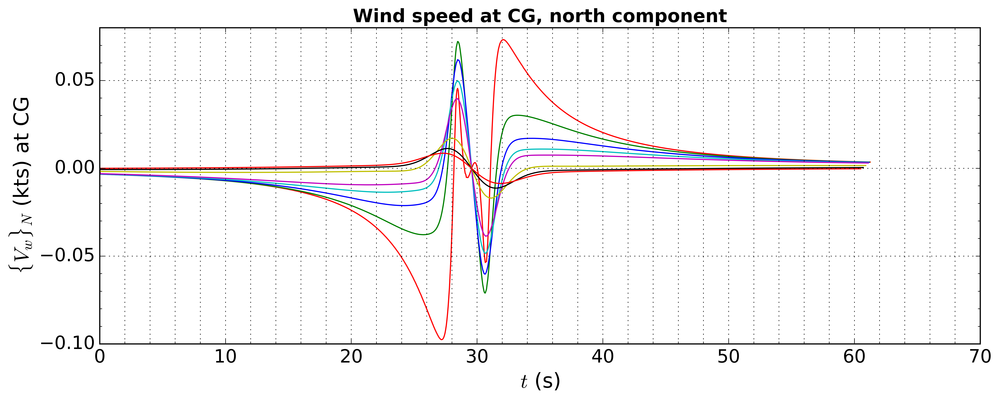

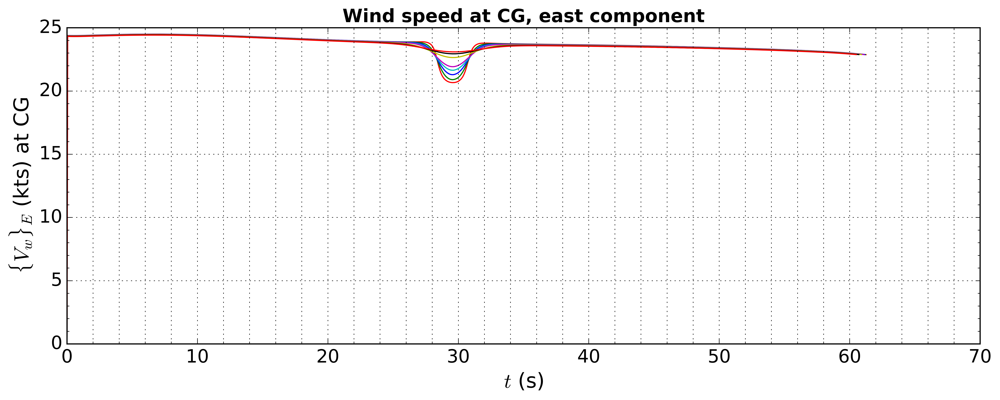

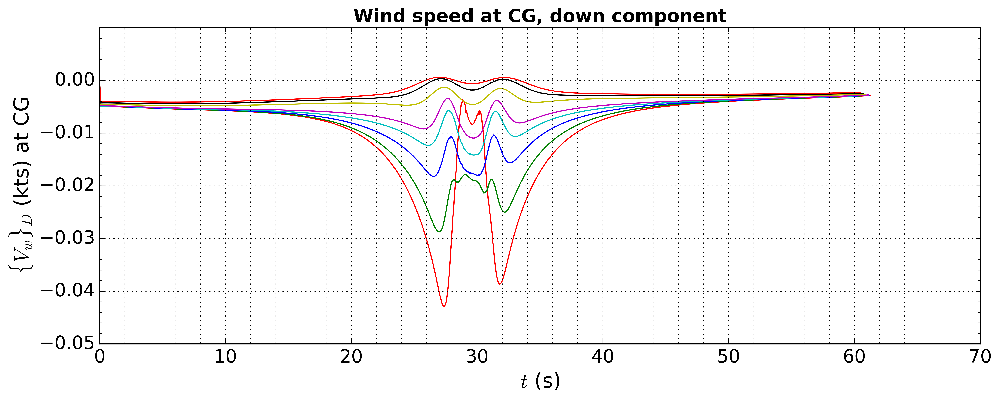

In [38]:
GrA.plot_vars('Vw_N_kts','Vw_E_kts','Vw_D_kts')
GrB.plot_vars('Vw_N_kts','Vw_E_kts','Vw_D_kts')

## Load factors

Total time required: 1.26 s
Total time required: 1.15 s


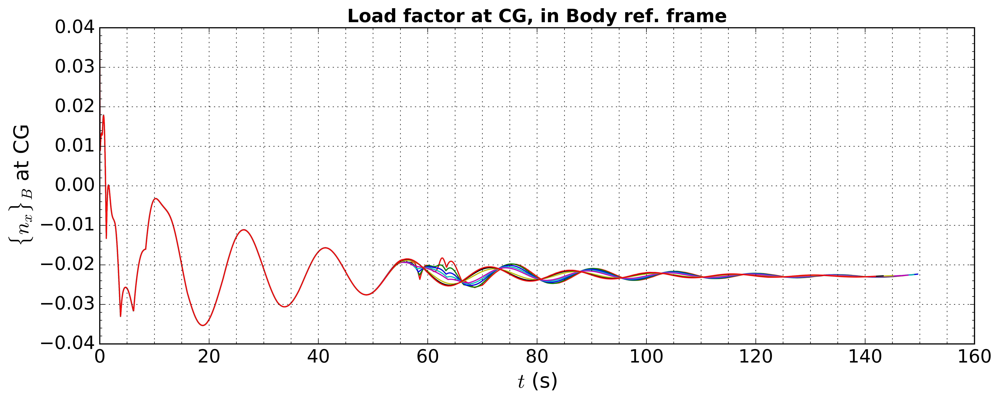

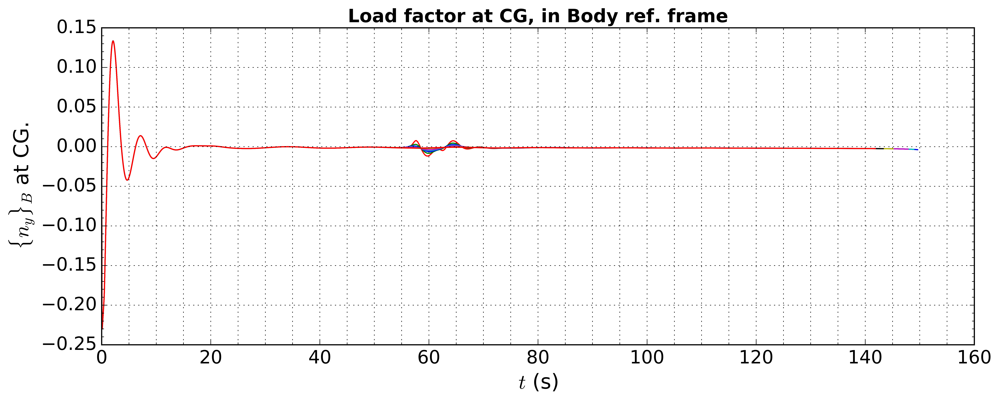

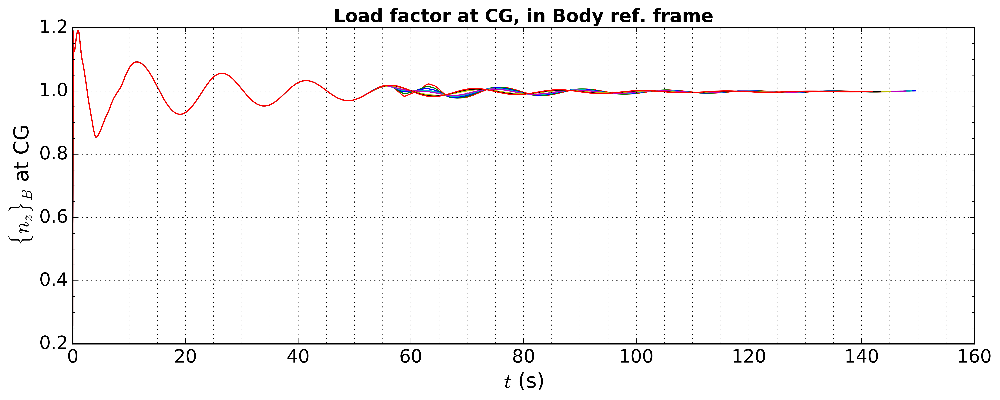

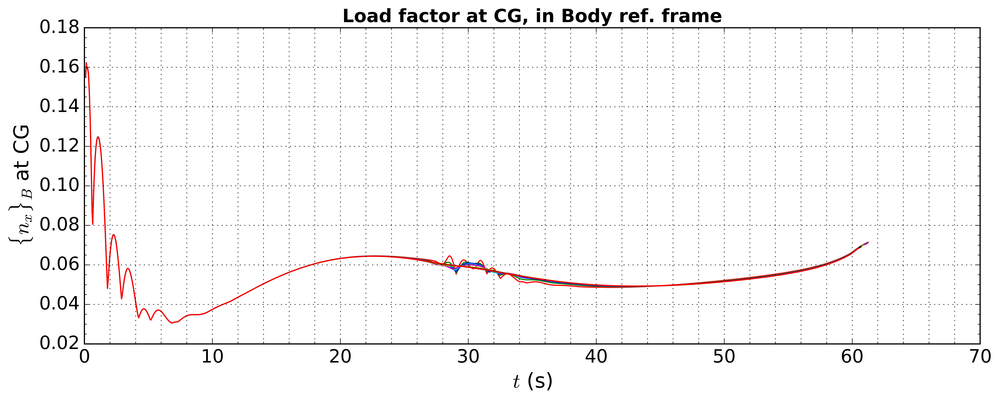

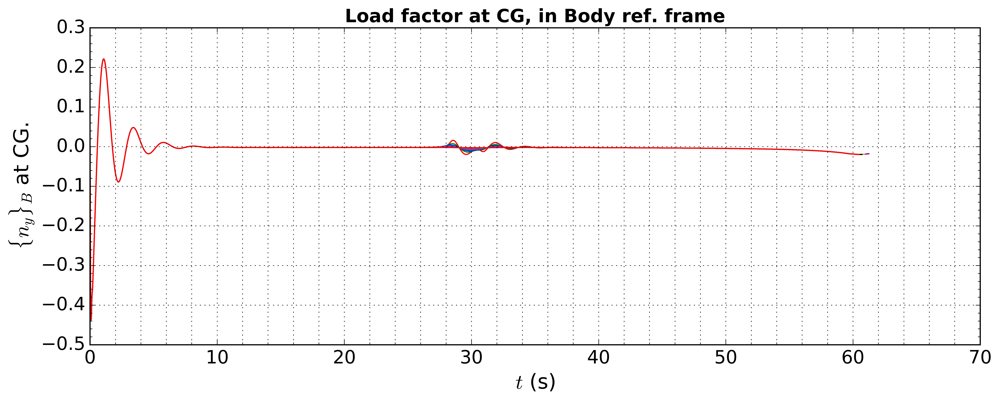

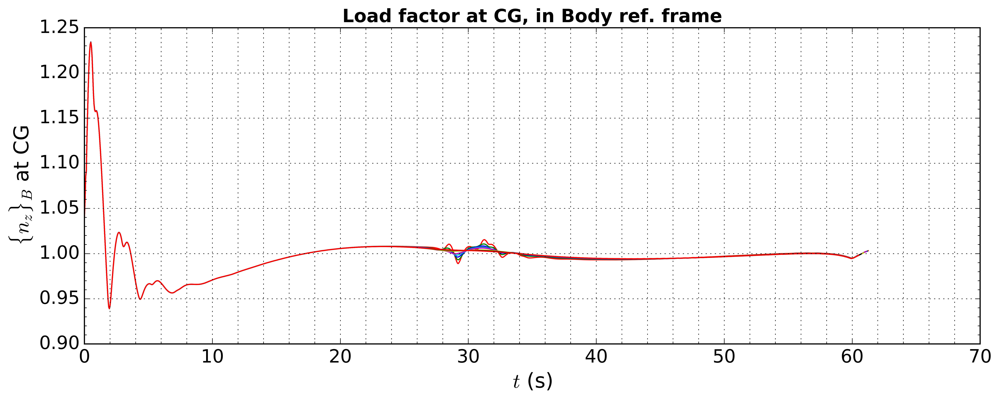

In [39]:
GrA.plot_vars('n_x','n_y','n_z')
GrB.plot_vars('n_x','n_y','n_z')